<a href="https://colab.research.google.com/github/Yassaadi/nutrientss-public-health/blob/main/Assaadi_Yassine_2_exploration_022023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
#GOOGLE COLAB
from google.colab import drive
drive.mount('/content/drive/')
%cd /content/drive/MyDrive/Colab Notebooks/P3-Public_health

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
/content/drive/MyDrive/Colab Notebooks/P3-Public_health


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots

import random
from scipy import stats
from scipy.stats import rv_histogram

#Statistic tests
 #Chi2: qualitattive variables independency 
from scipy.stats import chi2_contingency 
 #Oneway ANOVA: Independecy for mixte variables 
from scipy.stats import f_oneway 
 #Normality tests
from scipy.stats import anderson 
from scipy.stats import shapiro
from scipy.stats import normaltest

import missingno as msno
import math
import pylab
import re
import plotly.express as px
import statsmodels.api as sm

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder

from sklearn.impute import KNNImputer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn import decomposition

#Columns & rows size
pd.set_option('display.max_rows', None) 
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None) 

#graphs default configuration
plt.rcParams['figure.figsize']=(10,6)
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_formats = ['svg']

# Useful functions

## Dataframe usage memory

In [4]:
def memory(df, name):
  total_mem_usage = df.memory_usage().sum() / 10**6 #To get memory usage in Megabytes
  print(f'Memory usage of {name} DataFrame is {total_mem_usage} MB')

## Missing values map

In [5]:
def nan_map(df):
  ax = msno.matrix(df, figsize=(10,5))
  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)
  plt.show()

## Nan filter

In [6]:
def filterna(df,x):
  return df.loc[df[x].notna(),:]

## Deleting under limit of available data

In [7]:
def DropLimit(df, limit, column):
  dfi = df.copy()
  if column:
    for column in dfi: 
        if dfi[column].notnull().sum() < limit:
            dfi=dfi.drop(column,axis=1)
  if column == False:
    dfi = dfi[dfi.notnull().mean(axis = 1) > limit]
  
  #print(f'Dataframe old shape {df.shape}\nDataframe new shape {dfi.shape}')     
  return dfi  

## Shape metrics dataframe

In [8]:
lower_percentile = 1
upper_percentile = 99

def shape_metrics (df, lower_percentile, upper_percentile ):
    #Adapt data type to function: Convert pd.series to pd.DataFrame type
  if isinstance(df, pd.DataFrame):
    dfT= df.copy()
  elif isinstance(df, pd.Series):
    dfT = df.to_frame()

  Describe = dfT.describe().T
  Describe =Describe.reset_index().drop(['index','count'], axis=1).round(2)
  skew_ind = dfT.skew(axis = 0)
  kurt_ind = dfT.kurt(axis = 0)

  shape_ind = skew_ind.to_frame().reset_index().round(2)
  shape_ind['Kurtosis']= kurt_ind.to_frame().reset_index()[0].round(2)
  shape_ind = shape_ind.rename(columns={'index':'variables', 0:'skewness'})
  shape_ind[Describe.columns] = Describe

  Percet_a="Percentile"+str(lower_percentile)
  Percet_b="Percentile"+str(upper_percentile)
  percentile_a=[]
  percentile_b=[]

  for col in dfT.columns:
    percentile_a.append(np.percentile( dfT[col], lower_percentile, interpolation = 'midpoint'))
    percentile_b.append(np.percentile( dfT[col], upper_percentile, interpolation = 'midpoint'))

  shape_ind[Percet_a]= pd.Series(percentile_a)
  shape_ind[Percet_b]= pd.Series(percentile_b)

  return (shape_ind)

## Boxplot graph

In [9]:
def Boxplot(df, Linf, Lsup):
  df.boxplot(vert=False, figsize=(10,5));
  plt.gca().set(xlim=(Linf,Lsup))

## Pearson correlation map

In [10]:
def Pearson_corr(df,x,y,annot):
  plt.figure(figsize=(x, y))
  mask = np.triu(np.ones_like(df.corr(), dtype=bool))
  ax = sns.heatmap(
      df.corr(), 
      vmin=-1, vmax=1, center=0,
      cmap='RdYlGn',
      mask=mask,
      square=True,
      annot = annot,
      annot_kws={"size": 5})

  ax.set_title('Variables Correlation', fontdict={'fontsize':12}, pad=8);

  ax.set_xticklabels(
      ax.get_xticklabels(),
      rotation=45,
      horizontalalignment='right')

## Pairplot graph

In [11]:
def pairplot_violin(df, x, y):
  fig = px.scatter(df,
                  x=x,
                  y=y,
                  marginal_x="histogram",  # plot on x-axis margin
                  marginal_y="violin"  # plot on y-axis margin
                  )
  fig.update_layout(height=400, width=700, title=f'{x} and {y} scatter plot')
  fig.show
  return fig

## Outliers elimination

In [12]:
upper_lim=0.99
lower_lim=0.01

def Outliers_Cleaner(df, lower_lim, upper_lim, variables):
  #Adapt data type to function: Convert pd.series to pd.DataFrame type
  if isinstance(df,pd.Series) :
    dfT = df.to_frame()
  else :
    dfT = df.copy()
    
  #Compute quantiles and eleminate outliers
  for col in variables:
    print(f'{col}\nShape before outliers elimination = {dfT.shape}')
    Q1 = dfT[col].quantile(lower_lim)             
    Q3 = dfT[col].quantile(upper_lim)
    IQR = Q3 - Q1     
    dfT = dfT[ (dfT[col] <= (Q3 + 1.5*IQR)) & (dfT[col] >= (Q1 - 1.5*IQR)) ]
    print(f'Shape after outliers elimination = {dfT.shape}')
  return dfT

## Transformation function

In [13]:
def transform(df,boxcox,normalize):
  
  #Adapt data type to function: Convert pd.series to pd.DataFrame type
  if isinstance(df, pd.DataFrame):
    dfT= df.copy()
  elif isinstance(df, pd.Series):
    dfT = df.to_frame()

  #List of variables to transform/ Can be added as a parameter of the function  
  tran_list = dfT.columns  
  lmbdas= []
  Normalization = ColumnTransformer([("Normalization", StandardScaler(), tran_list)])
  Normalized = pd.DataFrame(Normalization.fit_transform(dfT), index= dfT.index,   columns= tran_list)

  #Transform to positive data   
  for column in tran_list :
    #Convert negative values
    if dfT[column].min() < 0 : 
      dfT[column] = dfT[column] - dfT[column].min() 

    #Translation to (>0)
    if (dfT[column].min() <= 0.0) & (dfT[column].max() > 0.0) : 
      dfT[column] = dfT[column] - dfT[column].min() + dfT[dfT[column]>0][column].min()
  
    if dfT[column].max() <= 0.0:
      dfT[column] = dfT[column] - dfT[column].min() - dfT[dfT[column]<0][column].max()
         
    #Boxcox/Logarithm transformation
    if boxcox:       
      BoxCox_data, lmbda = stats.boxcox(dfT[column])
      dfT[column] = BoxCox_data
      lmbdas.append([column,lmbda])     

    #Standard normalization
    if normalize:
      dfT[column] = Normalized[column]

  print(lmbdas)
  return dfT 

## Normality distribution

In [14]:
#Functions: Normality tests
def normality_test(df, x, r):
  
  dfT = filterna(df,x)[x].astype(float)
  #Adapting risa value to Anderson daring test
  risk_anderson= {15 : 0,
                 10 : 1,
                 5 : 2,
                 2.5 : 3,
                 1 : 4}

  #Shapiro wilk test
  stat1, p1 = shapiro(dfT)
  
  if p1<0.01*r:
    check1 = f"{x} is NOT normaly distributed" 
  else:
    check1 = f"{x} is Normaly distributed"

  #D’Agostino’s K-squared test
  stat2,p2 = normaltest(dfT)

  if p2<0.01*r:
    check2 = f"{x} is NOT Normaly distributed" 
  else:
    check2 = f"{x} is Normaly distributed"

  #Anderson-Darling Normality Test

  res = anderson(dfT)
  stat3 = res.statistic
  r=risk_anderson[r]

  # Compare the test statistic to the critical values to determine the p-value
  
  p3, cv = anderson(dfT, dist='norm').significance_level[r], anderson(dfT, dist='norm').critical_values[r]

  if stat3 < res.critical_values[r]:
      check3 = '%.3f, Normal' %cv
  else:
      check3 = '%.3f, NOT Normal' %cv

  print(f"Normality tests for {x}")

  test_df= pd.DataFrame([
                         ['Shapiro-Wilk',round(stat1,3), round(p1,3), check1], 
                         ['D’Agostino’s K2',round(stat2,3), round(p2,3), check2], 
                         ['Anderson-Darling', round(stat3,3), f'{p3}% level' ,check3]
                         ], 
                         columns=['Normality test', 'statistic', 'p-value', 'test result'] )
  return test_df
  
#-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

#Normality verification plots: Histogram and qqplot
def hist_qqplot(df, x):
  dfT = filterna(df,x)[x].astype(float)
  fig, ax = plt.subplots(1, 2, figsize=(10,5))

  # First subplot - Histogram
  ax[0].hist((dfT), bins=20, color='blue', edgecolor='gray')
  ax[0].set_title(f'{x} histogram', fontsize=12)
  ax[0].set_xlabel('Value', fontsize=10)
  ax[0].set_ylabel('Frequency', fontsize=10)

  # Second subplot - QQplot
  qq = stats.probplot((dfT), dist="norm", plot=plt)
  ax[1].set_title(f'{x} Probability plot', fontsize=12)
  ax[1].set_xlabel('Theoretical Quantiles', fontsize=10)
  ax[1].set_ylabel('Sample Quantiles', fontsize=10)

  plt.tight_layout()
  plt.show()

## PCA analysis 

In [15]:
def pca_variance(df, variables, n_components):
  
  pca = decomposition.PCA(n_components=n_components)
  X=df.loc[:, variables].dropna()
  pca.fit(X)


  # plot the explained variance
  PC_values = np.arange(pca.n_components_) + 1
  plt.plot(PC_values, pca.explained_variance_ratio_, 'o-', linewidth=2, color='blue')
  plt.title(f'Scree Plot')
  plt.xlabel('Principal Component')
  plt.ylabel('Variance Explained')
  plt.show()
  
  return pca.transform(X)

# Loading and converting data

In [16]:
path = '/content/drive/My Drive/Colab Notebooks/P3-Public_health/fr.openfoodfacts.org.products.csv'
#Macpath
path2= "/content/drive/MyDrive/Colab Notebooks/P3-Public_health/fr.openfoodfacts.org.products (1).csv"
txt = pd.read_csv(path, engine= 'python', sep='\\t', iterator=True, encoding='UTF8', chunksize=100)

#Loading data from csv file
data = pd.concat(txt, ignore_index=True) 
memory(data, 'initial')

#List of nutrients
num_variables = data.columns[data.columns.str.contains('_100g')].tolist()


#Data type coversion 
i=0
for col in num_variables:
  #Convert to float32 for memory matters
  data[col] = data[col].astype('float32')

  #Rename columns for visualization matters
  data = data.rename( columns= {col : col.replace('_100g','')})  
  num_variables[i] = col.replace('_100g','')
  i+=1
memory(data, 'converted')

#Reduced data for memory matters 
N = random.sample(range(int(data.shape[0])) , 200000 ) 
memory(data.iloc[N], 'reduced')

Memory usage of initial DataFrame is 415.72064 MB
Memory usage of converted DataFrame is 288.694928 MB
Memory usage of reduced DataFrame is 181.6 MB


# App principle 

In [17]:
Essential_nutrients = ["Protein", "Iron", "Zinc", "Calcium", "Vitamine<br>B12", "Omega 3"]

In [18]:
df_nutrient =pd.DataFrame(
    dict( daily_intake = ["46g/F", "18mg/F", "8mg/F", "1g/F", "2.4µg/F", "1.1g/F", "56g/M", "8mg/M", "11mg/M", "1g/M", "2.4µg/M", "1.6g/M"],
          Nutrient = Essential_nutrients + Essential_nutrients, 
          value = np.ones(shape=2*len(Essential_nutrients )))
               )

fig = px.sunburst(df_nutrient, path=['Nutrient', 'daily_intake' ], values = 'value', title ='Essential ntrients to track<br>Recommended daily intake<br>VEGITRACK')
fig.show()

In [19]:
# Features necessary for the app

app_variables =  ['proteins',
                  'iron', 
                  'zinc',          
                  'calcium' ,                 
                  'vitamin-b12',                 
                  'omega-3-fat' ]

RDI_Female = [46, 0.018, 0.008, 1, 0.0000024, 1.1]
RDI_Male = [56, 0.008, 0.011, 1, 0.0000024, 1.6]

df_RDI = pd.DataFrame(
    dict(Nutrient = app_variables, RDI_Female = RDI_Female  , RDI_Male = RDI_Male ))

# Data Cleaning

## Duplicates

In [20]:
n = data[data.duplicated()].shape[0]
print(f"Number of duplicated rows: {n}")

Number of duplicated rows: 0


# Categorical variables

### Variable 'categories_fr' 

In [21]:
df = data[['nutrition_grade_fr','pnns_groups_1','pnns_groups_2']]

#Function: Get str between text beginning and first found coma 
def match_str(text):
  match = re.search("^([^,]*)", text)
  return match.group(1)

#Reduce categories 
df['categories'] = data['categories_fr'].apply(lambda x : match_str(str(x)) if x!="nan" else x)

l1=len(data['categories_fr'].unique())
l2=len(df['categories'].unique())
print(f'categories initialy :{l1}\ncategories after selection :{l2}')

categories initialy :21163
categories after selection :3456


<ipython-input-21-8fa4539c5e1e>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Variable 'Quantity'

<ipython-input-22-6c3acda59fbe>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-22-6c3acda59fbe>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-22-6c3acda59fbe>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-22-6c3acda

Total units befor lexical tranformation 729
Total units after lexical tranformation 704
Total units after unit conversion 699


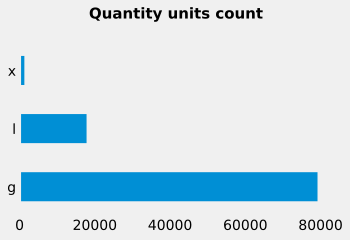

In [22]:
#Separate quantity numerical value and unit
df['quantity_unit'] = data['quantity'].str.extract('([a-zA-Z]+)', expand=False)
df['quantity_num'] = data['quantity'].str.extract('(\d+)', expand=False)
df['quantity_num'] = df['quantity_num'].astype('float32') 

# Define a dictionary to transform units

unit_transform = {
    'kilograms': 'kg',
    'kilogrammes': 'kg',
    'Kg': 'kg',
    'KG': 'kg',
    'gram' : 'g',
    'grams' : 'g',
    'grs' : 'g',
    'gr' : 'g',
    'grammes' : 'g',
    'gramos' : 'g',
    'G': 'g',
    'oz': 'oz',
    'OZ': 'oz',
    'L' : 'l',
    'litre' : 'l',
    'Litre' : 'l',
    'litres' : 'l',
    'Litres' : 'l',
    'litro' : 'l',
    'liter' : 'l',
    'Liter' : 'l',
    'lt' : 'l',
    'ml' : 'ml',
    'mL' : 'ml',
    'ML' : 'ml',
    'cl' : 'cl',
    'cL' : 'cl',
    'CL' : 'cl',
    'FL' : 'fl',
    'Fl' : 'fl',
    'fl' : 'fl'
}

# Define a dictionary for common units
unit_unif = {
    'kg': 'g',
    'oz': 'g',
    'ml' : 'l',
    'cl' : 'l',
    'fl' : 'l'  
}

# Define the conversion factor for each unit
unit_convert = {
    'kg': 1000,
    'g': 1,
    'mg' : 0.001,
    'l' : 1,
    'ml': 0.001,
    'cl' : 0.01,
    'fl' : 0.00001,
    'oz': 28.349
}

#Function: Define the custom function to convert units
def convert_units(row):
  if row['quantity_unit'] in unit_transform:
      factor_u = unit_convert[row['quantity_unit']]
      return row['quantity_num'] * factor_u
  else:
    return row['quantity_num'] 

# Apply the function to the column
l1 = len(df['quantity_unit'].unique())
data['q_unit'] = df['quantity_unit'].apply(lambda x: unit_transform[x] if x in unit_transform else x)

l2 = len(data['q_unit'].unique())
df['quantity_num'] = df.apply(lambda x: x.quantity_num * unit_convert[x.quantity_unit] if x.quantity_unit in unit_convert else x.quantity_num, axis=1)
#Add this new numerical variable to num_variables list
num_variables.append('quantity_num')

df['quantity_unit'] = data['q_unit'].apply(lambda x: unit_unif[x] if x in unit_unif else x)
l3=len(df['quantity_unit'].unique())

print(f'Total units befor lexical tranformation {l1}\nTotal units after lexical tranformation {l2}\nTotal units after unit conversion {l3}')

#-------------------------------------------------------------------------------------------------------------------------------------------------------------

#quantity units count plot
x = df['quantity_unit'].value_counts()
#Show most common units
x=x[x>1000]
#Plot common units 
plt.figure(figsize=(5,3))
x.plot(kind='barh', grid=False) 
plt.title('Quantity units count\n',fontweight ="bold", fontsize=15) 
plt.show()

### Encoding categorical variables

In [23]:
LE = LabelEncoder()

df['quantity_unit_encod'] = df.loc[:,'quantity_unit']
df["categories"] =data.loc[:,'categories']

for col in ["categories", 'quantity_unit_encod','nutrition_grade_fr','pnns_groups_1','pnns_groups_2']: 
  df.loc[df[col].notna(),col] = LE.fit_transform(df.loc[df[col].notna(),col]) 

<ipython-input-23-bb75b36be437>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-23-bb75b36be437>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [24]:
catg_variables = ['categories', 'quantity_unit_encod', 'nutrition_grade_fr','pnns_groups_1','pnns_groups_2']

## Pre-cleaned data

In [25]:
for col in num_variables:
   if col not in df.columns.tolist():
     df[col] = data.loc[:,col]

<ipython-input-25-9395a43bae7b>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-9395a43bae7b>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-9395a43bae7b>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-9395a43

Text(0.5, 1.0, 'Percentage of available data initially')

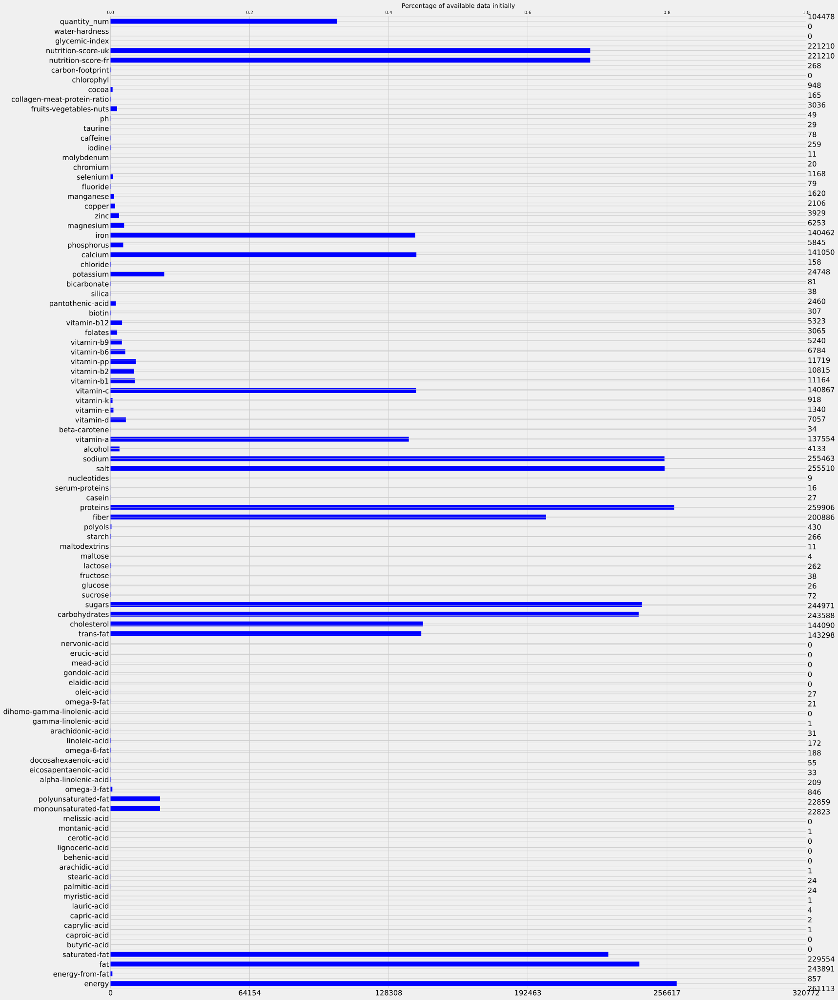

In [26]:
msno.bar(df[num_variables], color='blue')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title('Percentage of available data initially', fontsize=14)

# Missing values elemination



Text(0.5, 1.0, 'Available after elimination of >99% Nan Variables and >90% Nan products')

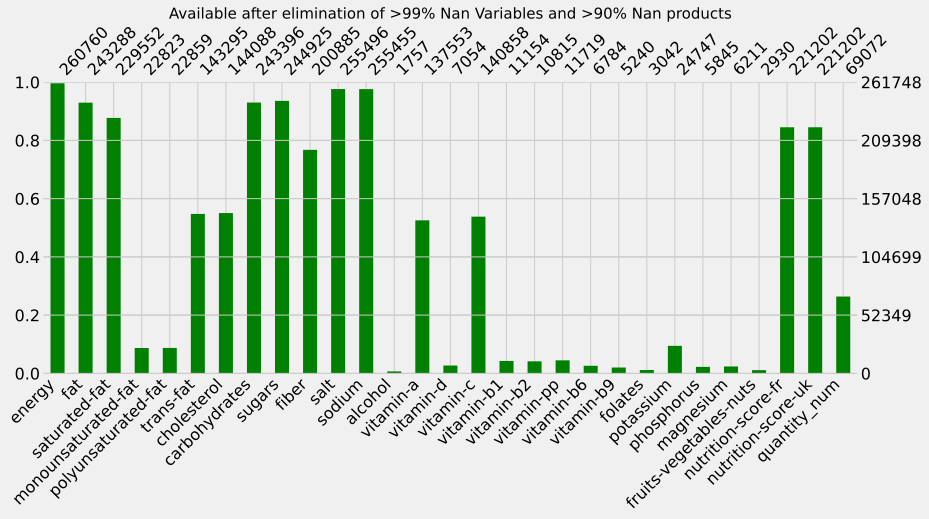

In [27]:
#Separate app_variables from Nutrients for treatment matters
list = [x for x in num_variables if x not in app_variables]

# Step1: Elemination of excessive NAN variables
df_num1 = DropLimit(df[list], 3000, True)

#Remove poor data variables from num_variables list
num_variables = df_num1.columns.tolist()


# Step2: Elimination excessive NAN products
df_num = DropLimit(df_num1, 0.1 , False)
df = df.loc[df_num.index,:]

msno.bar(df[num_variables], color="green" , figsize=(13,5))
plt.title('Available after elimination of >99% Nan Variables and >90% Nan products', fontsize=15)

Text(0.5, 1.0, 'Available data for app variables')

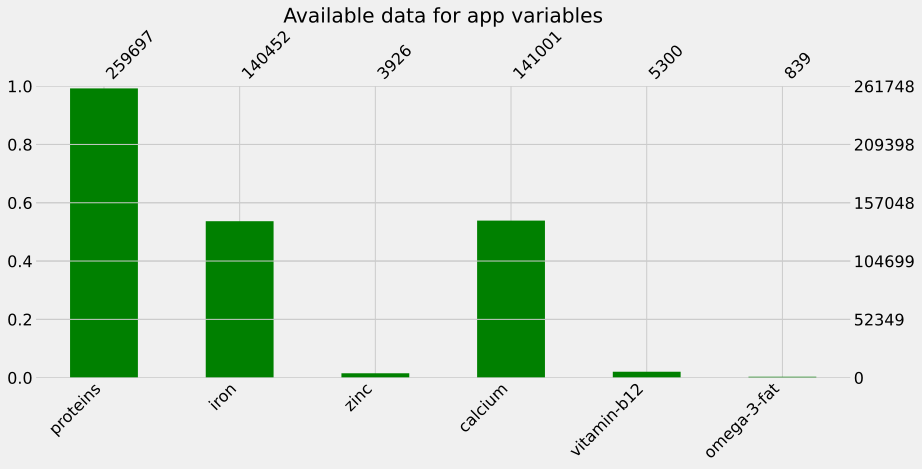

In [28]:
#Percentage of NAN in app_variables in the cleaned dataframe
msno.bar(df[app_variables], color="green" , figsize=(13,5))
plt.title('Available data for app variables')

### Commentaire: Réglement INCO
Le contenu de la déclaration nutritionnelle obligatoire inclut les éléments suivants : la valeur énergétique, la quantité des matières grasses, d’acides gras saturés, de glucides, de sucres, de protéines et de sel.

# Multivariate analysis : variables independence

## Quantitative variables

#### Pearson's Correlation

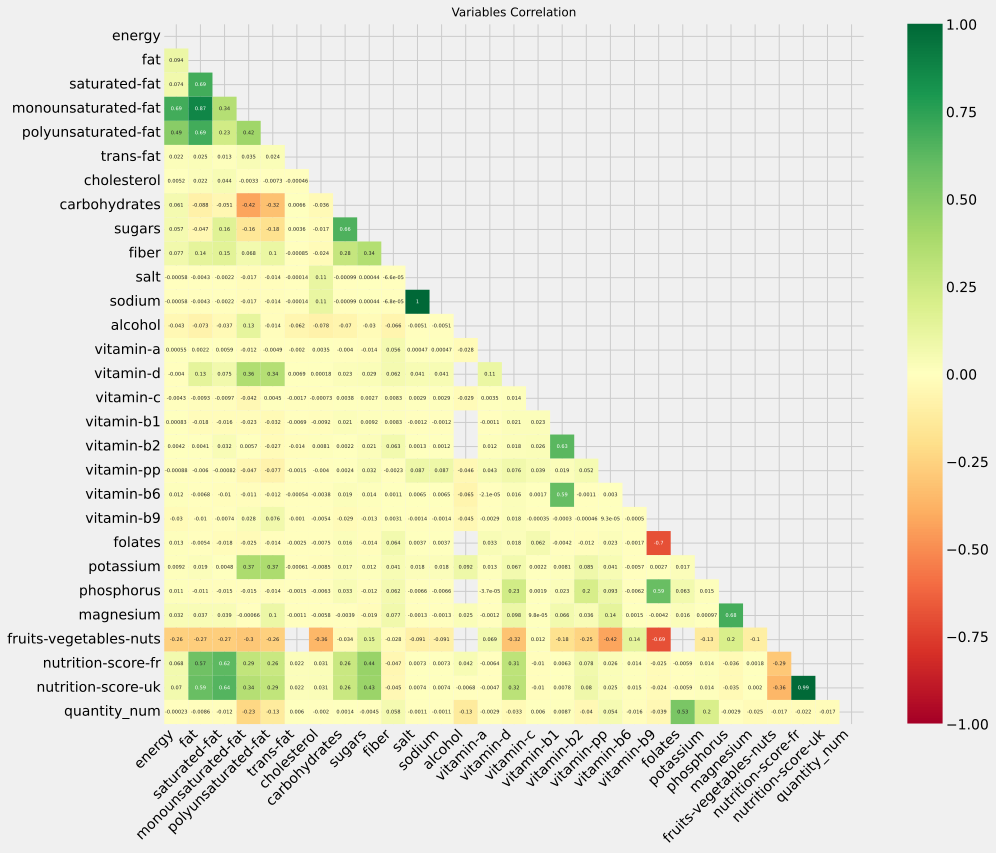

In [29]:
Pearson_corr(df[num_variables],14,12, True)


> 1.Eliminaton of variables with very low correlation to app variables

> 2.Among these variables, elmination of those holding the same information (Very correlated to each other)



In [30]:
#Columns highly correlated to drop/ hold the same info 
drop_list = ['saturated-fat', 'trans-fat', 'polyunsaturated-fat', 'monounsaturated-fat' , 'sodium','alcohol',
             'vitamin-b6', 'vitamin-b1', 'vitamin-c', 'vitamin-a', 'alcohol', 'sodium', 'salt', 'fiber', 'sugars',
             'potassium','carbohydrates', 'cholesterol', 'nutrition-score-uk']

corr_variables = [x for x in num_variables if not (x in drop_list or x in app_variables)]

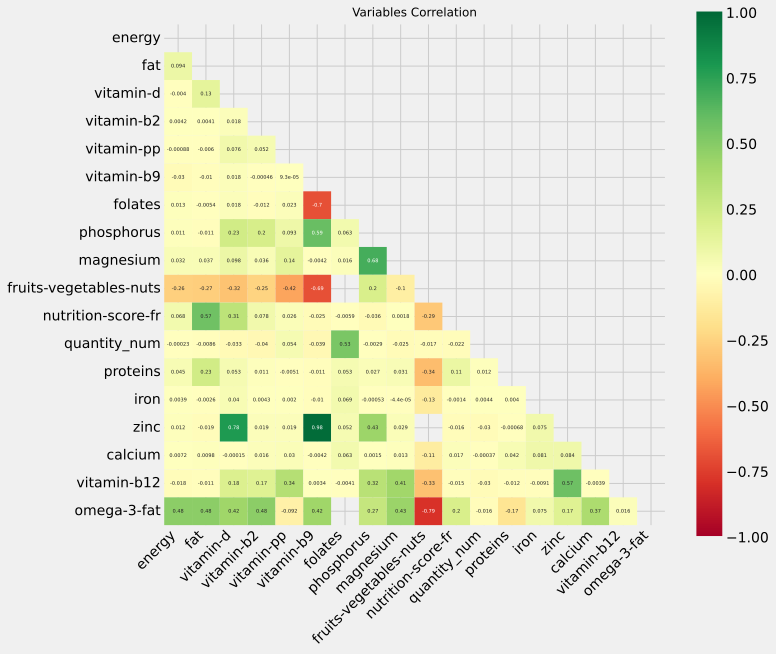

In [31]:
Pearson_corr(df[corr_variables+app_variables],10,9, True) 

Numerical variables correlated to app variables:



*   iron: [fruits-vegetables-nuts]
*   omega-3-fat: [energy, fat, vitamin-d, vitamin-b2, vitamin-b9, magnesium, fruits-vegetables-nuts]
*   calcium: [fruits-vegetables-nuts, omega-3-fat]
*   vitamin-b12 : [vitamin-pp, magnesium, fruits-vegetables-nuts]
*   zinc: [vitamin-d, vitamin-b9, vitamin-b12, phosphorus]
*   proteins: [fat, fruits-vegetables-nuts]












## Qualitative variables: Chi-2 test

### Normality check

In [32]:
#Performing normality tests with a 5% risk for chosen categorical variables
for x in catg_variables:
  print(normality_test(df, x, 5))

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.



Normality tests for categories
     Normality test  statistic     p-value  \
0      Shapiro-Wilk      0.955         0.0   
1   D’Agostino’s K2  59526.874         0.0   
2  Anderson-Darling    803.261  5.0% level   

                             test result  
0  categories is NOT normaly distributed  
1  categories is NOT Normaly distributed  
2                      0.787, NOT Normal  
Normality tests for quantity_unit_encod
     Normality test  statistic     p-value  \
0      Shapiro-Wilk      0.410         0.0   
1   D’Agostino’s K2  36061.685         0.0   
2  Anderson-Darling  15466.860  5.0% level   

                                      test result  
0  quantity_unit_encod is NOT normaly distributed  
1  quantity_unit_encod is NOT Normaly distributed  
2                               0.787, NOT Normal  


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.



Normality tests for nutrition_grade_fr
     Normality test   statistic     p-value  \
0      Shapiro-Wilk       0.891         0.0   
1   D’Agostino’s K2  108027.605         0.0   
2  Anderson-Darling    8203.664  5.0% level   

                                     test result  
0  nutrition_grade_fr is NOT normaly distributed  
1  nutrition_grade_fr is NOT Normaly distributed  
2                              0.787, NOT Normal  
Normality tests for pnns_groups_1
     Normality test  statistic     p-value  \
0      Shapiro-Wilk      0.899         0.0   
1   D’Agostino’s K2  17789.960         0.0   
2  Anderson-Darling   2005.980  5.0% level   

                                test result  
0  pnns_groups_1 is NOT normaly distributed  
1  pnns_groups_1 is NOT Normaly distributed  
2                         0.787, NOT Normal  
Normality tests for pnns_groups_2
     Normality test    statistic     p-value  \
0      Shapiro-Wilk        0.911         0.0   
1   D’Agostino’s K2  1080931.210   

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.



In [33]:
hist_qqplot(df,"nutrition_grade_fr")

Non normal varibales, we can not processs Chi-2 independence test on categorical variables.

# Tranformation of numerical variables

# Variables distribution

In [34]:
shape_metrics(df[corr_variables],1,99)

<ipython-input-8-4759940f8851>:27: DeprecationWarning:

the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)

<ipython-input-8-4759940f8851>:28: DeprecationWarning:

the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)



,variables,skewness,Kurtosis,mean,std,min,25%,50%,75%,max,Percentile1,Percentile99
0,energy,490.69,247065.88,1142.07,6451.44,0.0,377.00,1100.00,1674.00,3251373.00,NaN,NaN
1,fat,2.47,17.25,12.71,17.57,0.0,0.00,5.00,20.00,714.29,NaN,NaN
2,vitamin-d,82.36,6860.51,0.00,0.00,0.0,0.00,0.00,0.00,0.03,NaN,NaN
3,vitamin-b2,26.55,815.86,0.26,1.28,0.0,0.00,0.01,0.30,42.50,NaN,NaN
4,vitamin-pp,63.03,4424.97,0.01,0.27,0.0,0.00,0.01,0.01,21.43,NaN,NaN
5,vitamin-b9,63.83,4313.44,0.01,0.34,0.0,0.00,0.00,0.00,23.08,NaN,NaN
6,folates,29.83,943.85,0.21,5.13,0.0,0.00,0.00,0.00,178.57,NaN,NaN
7,phosphorus,36.29,1387.37,0.62,12.06,0.0,0.09,0.21,0.36,559.46,NaN,NaN
8,magnesium,38.29,1591.14,0.54,13.54,0.0,0.02,0.08,0.14,657.14,NaN,NaN
9,fruits-vegetables-nuts,0.73,-0.64,30.69,31.99,0.0,0.00,20.00,50.00,100.00,NaN,NaN


In [35]:
shape_metrics(df[app_variables],1,99)

<ipython-input-8-4759940f8851>:27: DeprecationWarning:

the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)

<ipython-input-8-4759940f8851>:28: DeprecationWarning:

the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)



,variables,skewness,Kurtosis,mean,std,min,25%,50%,75%,max,Percentile1,Percentile99
0,proteins,-1.820000,409.950012,7.07,8.41,-800.0,0.7,4.76,10.00,430.00,NaN,NaN
1,iron,186.509995,39540.800781,0.00,0.21,-0.0,0.0,0.00,0.00,50.00,NaN,NaN
2,zinc,43.970001,2035.030029,0.01,0.08,0.0,0.0,0.00,0.01,4.00,NaN,NaN
3,calcium,161.339996,28838.310547,0.12,3.32,0.0,0.0,0.04,0.11,694.74,NaN,NaN
4,vitamin-b12,72.040001,5221.830078,0.00,0.01,0.0,0.0,0.00,0.00,0.40,NaN,NaN
5,omega-3-fat,5.680000,43.220001,3.19,5.61,0.0,0.6,1.80,3.20,60.00,NaN,NaN


# Outliers

We compare variables boxplots. I exclude quantity_num and energy as they are note expressed in g by 100g/ml


In [36]:
boxlist = ['fat','vitamin-d','vitamin-b2', 'vitamin-pp', 'vitamin-b9','folates', 'phosphorus', 'magnesium', 'fruits-vegetables-nuts', 'nutrition-score-fr']

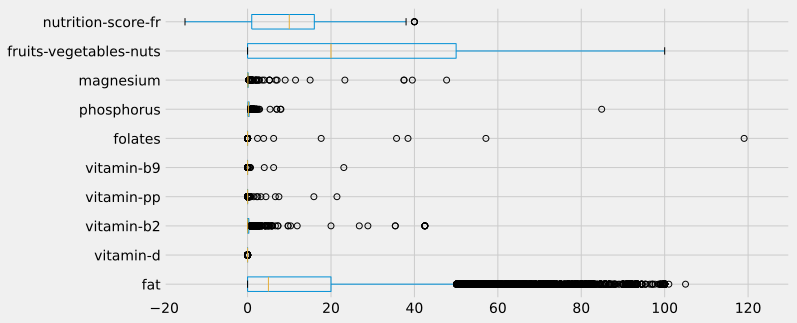

In [37]:
Boxplot(df[boxlist], -20, 130)

In [38]:
Boxplot(df[app_variables], -30, 200)

All values exceeding 100g and negative values are abnormal, they are then eliminated

In [39]:
for col in [boxlist+app_variables] :
  dfo = df[ (df[col]<100) & (df[col]>0)]

In [40]:
Boxplot(dfo[boxlist+app_variables], -50, 300)

In [41]:
# Calculate the lower and upper bounds for the x-axis
dfT=df[["omega-3-fat", "iron"]]
Linf, Lsup = dfT.min().min(), df.max().max()

# Plot the boxplot
dfT.boxplot(vert=False, figsize=(10,5))

# Set the x-axis limits
plt.gca().set(xlim=(Linf,Lsup))

# Find the outliers in each column
for column in dfT.columns:
    outliers = dfT[dfT[column] > dfT[column].quantile(0.75) + 1.5 * (dfT[column].quantile(0.75) - dfT[column].quantile(0.25))]
    names = outliers.index
    for name in names:
        plt.text(dfT[column].loc[name], 1, name, ha='center')

plt.show()

<ipython-input-41-af41d1591ed6>:3: FutureWarning:

The default value of numeric_only in DataFrame.max is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



### Quantity

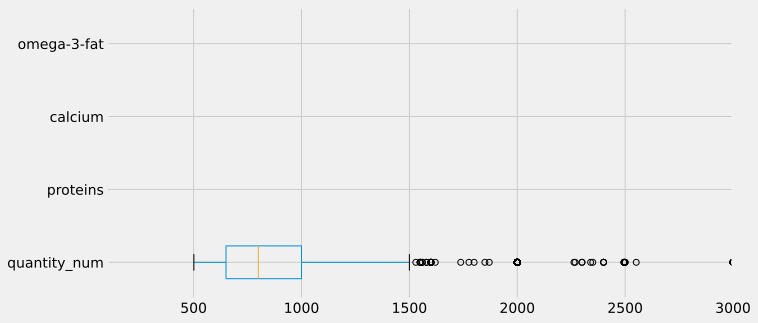

In [42]:
list2 = ["quantity_num","proteins", "calcium" , "omega-3-fat"]
df_g = df.loc[df['quantity_unit']=='g']
df_l = df.loc[df['quantity_unit']=='l']
df_x = df.loc[df['quantity_num']>500]
#Boxplot(df_g[corr_variables], -30, 1000)
Boxplot(df_x[list2], 100, 3000)

# Save to csv the cleaning file

In [43]:
path = '/content/drive/My Drive/Colab Notebooks/P3-Public_health/P3_data_cleaned.csv'

df.to_csv(path_or_buf = path, index_label = 'index')